# Analyse Dimension Reduction Algorithms

## ReadMe

This notebook contains supplementary materials for my bachelor thesis.

Thesis topic: Analysing the UMAP dimension reduction algorithm, Advisor: Prof. Dr. Jochen Garcke

We will compare the UMAP alorithm with PCA, t-SNE and TriMap, using the MNIST and FMNIST datasets and Cartoon Set dataset.

All experiments are pre run and can be accessed through their unique file number. 
The filenumbers don't have any intuitive structure since they evolved over the course of my thesis ;-).
We created a 2-level access. While our precomuted data should be stored in a file with the following structure: 'source_experimentnumber_rep.npy'.
The source specifies the dataset sould be [cartoon, mnist, fmnist]. And experimentnumber specifies the settings and algorithm used for dimension reduction. 
See the 'experiments.txt' file for various settings. Not all experiments were run for every dataset.

As a plotting libary we use holoviews. This is highly custumizable and allows use to make complicated plots.
The main function we are using is ```plot_experiments```. The most important parameters for this function are:

```src``` this specifies the dataset which should be plotted

```experiments``` specifies a list of pre computed experiments storing the low (i.e. 2) dimensional representation.

```attr``` this parameter is used for the cartoon set to change the color map. Best values to choose are 'nhair', 'nhair_color' and 'nface_color'.

______________________

### TL;DR 
#### Just execute the cells and enjoy the beauty of the predefined plots. Be aware of the holoviews/bokeh tools, like lasso select, zooming and paning.

### Getting set up

Instaling the requirements using conda.

```
conda create -n thesis-reiners python=3.6
conda activate thesis-reiners
conda install -c pyviz holoviz
holoviz examples
cd holoviz-examples
jupyter notebook
```

In [1]:
# use this cell to make juypter utilize full screen width

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
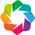

In [2]:
# some imports
# we recommend using a conda environement

import numpy as np
import pandas as pd
import holoviews as hv
from holoviews import opts
hv.extension('bokeh')
hv.renderer('bokeh').theme = 'light_minimal'  # more LaTeX looking style

import bokeh
import datashader as ds # using datashader for plots containing more than 10k points, otherwise the browser might crash... we loose the interactivity though :(
from holoviews.operation.datashader import datashade, dynspread 
from holoviews.plotting.links import DataLink # using this function to link plots and utilize the bokeh lasso select tool

from itertools import combinations  #used to DataLink all subplots
from ast import literal_eval as leval # used to read log files containing experiment information

import feather # used to read cartoon meta data
import pickle # used to read some predefined python objects

import os # used for filenames

In [9]:
# defining some file paths, should work if all files are downloaded correctly

#FILE_PATH = os.path.basename(os.path.dirname(__file__))
REP_PATH = os.path.join('..', 'data') # this folder should contain all the experiments we want to run
CARTOON_PATH = os.path.join('..', 'cartoon') # this folder should contain the cartoon set meta data
META_PATH = os.path.join('..') # starting from this folder we will search for images of MNIST and FMNIST

In [5]:
# some functions, just execute this cell and start playing with the plots defined below.

def load_cartoon_meta(n_file=1, src='cartoon'):
    with open(os.path.join(CARTOON_PATH, 'attr_dict.pickle'), 'rb') as handle:
        attr_dict = pickle.load(handle)

    if src == 'cartoon10k':
    	df = pd.read_feather(os.path.join(CARTOON_PATH, 'cartoon10k_meta.feather'))
        #raise ValueError('Import cartoon10k meta.')
    else: 
        df_list = []
        for i in range(n_file):
            df_list.append(pd.read_feather(os.path.join(CARTOON_PATH, 'meta100k', 'cartoon100k_'+ str(i) +'_meta.feather'))) 
        df = df_list[0]

        for i in range(1, n_file):
            df = df.append(df_list[i])

    return df, attr_dict


def add_experiments(experiments, src, df):
    for exp in experiments:
        if not any('x_'+str(exp) == s for s in df.columns.tolist()): 
            file_name = os.path.join(REP_PATH, src + '_rep', src + '_' + str(exp) + '_rep.npy')
            rep = np.load(file_name)

            n_samples = len(df)

            df['x_'+str(exp)] = rep[:n_samples,0]
            df['y_'+str(exp)] = rep[:n_samples,1]

            #print('Experiment {} added.'.format(exp))
        #else:
            #warnings.warn('Experiment {} already in df.'.format(exp))

    if df.isna().sum().sum():
        warn('Please check that data is complete. There are NaNs.')

    return df


def get_label(exp, src):
    settings = None
    with open(os.path.join(REP_PATH, src + '_rep', src + '_' + str(exp) + '_log.txt'), 'r') as f:
        fl = f.readlines()
        algorithm = fl[4][:-1]
        shape = fl[8][:-1]
        settings = leval(fl[12])
        if 'random_state' in settings:
            del settings['random_state']

    return algorithm + ' trained on (' +shape + ') with: ' + str(settings)


def plot_experiments(src, experiments, attr=None, n_samples=10000, single_mode=False, save=False, title=None, width=500, n_cols=3, cmap=None, bgcolor='white', alpha=0.7):
    if type(experiments) == int:
        experiments = [experiments]

    if src == 'mnist' or src == 'fmnist':
        attr = 'labels'
        cmap = 'Category10'
        df = pd.read_feather(os.path.join(META_PATH, src, src+'_meta.feather'))

    elif src == 'cartoon' or src == 'cartoon10k':
        n_file = int(np.ceil(n_samples/10000))
        df, attr_dict = load_cartoon_meta(n_file=n_file, src=src)

        if attr is None:
            print('TODO: implement DynamicMap for src=cartoon and attr=None')
            attr = 'nhair'

        if cmap is None:
            if attr == 'nhair':
                cmap = 'Category20'
            else:
                cmap = 'viridis'

    if n_samples == -1:
        n_samples = df.shape[0]
        
    df = df.iloc[:n_samples]
    
    df = add_experiments(experiments, src, df)

    if title is None:
        title = src + ' plotting ' + str(n_samples) + ' datapoints'
        
    if n_samples > 10000:
        print('Using datashader if n_samples > 10k')
        scatter_options = opts.Scatter(width=width, aspect=1, xaxis='bare', yaxis=None,
                                       colorbar=False)
        

        scatter_list = [dynspread(datashade(hv.Scatter(df, 'x_'+str(e), ['y_'+str(e), attr], label=get_label(e, src)).opts(scatter_options), 
                                            aggregator=ds.count_cat(attr), cmap=cmap)\
                                  .opts(width=width, aspect=1, bgcolor=bgcolor, xlabel='', ylabel='', xticks=4, yticks=4)) 
                        for e in experiments]
    else: 
        str_tooltips = "\
                <div> \
                    <img src=\"@path\" width=\"100\" height=\"100\"></img> \
                </div> \
                <div> \
                    <span style=\"font-size: 12px;\">label: @labels</span> \
                </div> \
                "
            
        hover = bokeh.models.HoverTool(tooltips=str_tooltips)

        scatter_options = opts.Scatter(width=width, aspect=1, xlabel='', ylabel='', xticks=4, yticks=4,
                                       colorbar=False, cmap=cmap,
                                       nonselection_alpha=0.005, nonselection_color='black',
                                       tools=[hover,'box_select', 'lasso_select'], alpha=alpha)

        if single_mode:
            raise ValueError('Implement single_mode (no layout just DynamicMap)')  # TODO: single_mode

        scatter_list = [hv.Scatter(df, 'x_'+str(e), ['y_'+str(e), attr, 'path', 'labels'], label=get_label(e, src)).opts(scatter_options).opts(color=hv.dim(attr)) 
                        for e in experiments]

        
        if len(scatter_list) > 2:
            [DataLink(scatter1, scatter2) for scatter1, scatter2 in combinations(scatter_list, 2)]
            DataLink(scatter_list[0], scatter_list[1])

    layout = hv.Layout(scatter_list)
    
    if save:
        print('Saving layout to ../saved_plots/{}'.format(title))
        hv.renderer('bokeh').save(layout.opts(toolbar=None).opts(opts.Scatter(show_title=False)).cols(3), '../saved_plots/'+title, fmt='png')

    return layout.cols(n_cols).relabel(title).opts(opts.Scatter(show_title=True))

## Now let's start looking at some predefined plots

In [ ]:
width = 500  # set the width acorrding to screen size (we recommend 500 for bigger screens, 300 for smaller ones)

### Cartoon Set

First lets get some insight on the global structure of the Cartoon Set using the well known PCA method.

In [ ]:
# plotting the cartoon set data using pca
# we can get information on the global structure

source = 'cartoon'
exps = [999]  # experiment number which stores pre comuted data (number 999 is pca). 

pca_cartoon = plot_experiments(src=source, exxperiments=exps, attr='nhair') + plot_experiments(source, exps, 'nface_color') + plot_experiments(source, exps, 'nhair_color')
pca_cartoon

Let's compare UMAP with tSNE and TriMap on the cartoon set. 

Feel free to use the Bokeh zooming, paning and lasso select tools for better interactivity.

In [22]:
# focus on local structure i.e. face and hair color

source = 'cartoon'
exps = [7320, 78, 85]
attr = 'nhair_color'
attr2 = 'nface_color'

layout1 = plot_experiments(source, exps, attr, width=width)
layout2 = plot_experiments(source, exps, attr2, width=width)

cartoon_local = (layout1 + layout2).cols(3)
cartoon_local

:Layout
   .Scatter.Umap_trained_on_left_parenthesis_10000_comma_360000_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_50_right_curly_bracket :Scatter   [x_7320]   (y_7320,nhair_color,path,labels)
   .Scatter.Tsne_trained_on_left_parenthesis_10000_comma_360000_right_parenthesis_with_colon_left_curly_bracket_apostrophe_perplexity_apostrophe_colon_40_right_curly_bracket  :Scatter   [x_78]   (y_78,nhair_color,path,labels)
   .Scatter.Trimap_trained_on_left_parenthesis_10000_comma_360000_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_inliers_apostrophe_colon_40_right_curly_bracket :Scatter   [x_85]   (y_85,nhair_color,path,labels)
   .Scatter.I                                                                                                                                                                  :Scatter   [x_7320]   (y_7320,nface_color,path,labels)
   .Scatter.II                                                                                                                                                                 :Scatter   [x_78]   (y_78,nface_color,path,labels)
   .Scatter.III                                                                                                                                                                :Scatter   [x_85]   (y_85,nface_color,path,labels)

In [16]:
# focus on different input dimensions

source = 'cartoon'
exps = [999, 7320, 12350]
attr = 'nhair_color'

cartoon_dims = plot_experiments(source, exps, attr, width=width)
cartoon_dims

:Layout
   .Scatter.Pca_trained_on_left_parenthesis_50000_comma_360000_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_components_apostrophe_colon_2_right_curly_bracket  :Scatter   [x_999]   (y_999,nhair_color,path,labels)
   .Scatter.Umap_trained_on_left_parenthesis_10000_comma_360000_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_50_right_curly_bracket :Scatter   [x_7320]   (y_7320,nhair_color,path,labels)
   .Scatter.Gumap_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_40_right_curly_bracket   :Scatter   [x_12350]   (y_12350,nhair_color,path,labels)

In [21]:
source = 'mnist'
#source = 'fmnist'
#source = 'cartoon'
#experiments = [72, 120, 121, 122, 123, 124]
#experiments = [85, 86, 87, 120, 121, 122]
#experiments = [73, 77, 86, 87, 88, 89]
experiments = [73, 78, 83, 86, 123]

fmnist_plot = plot_experiments(source, experiments, n_samples=70000, title='fmnist_70k')
fmnist_plot

Using datashader if n_samples > 10k


:Layout
   .DynamicMap.I   :DynamicMap   []
      :RGB   [x_73,y_73]   (R,G,B,A)
   .DynamicMap.II  :DynamicMap   []
      :RGB   [x_78,y_78]   (R,G,B,A)
   .DynamicMap.III :DynamicMap   []
      :RGB   [x_83,y_83]   (R,G,B,A)
   .DynamicMap.IV  :DynamicMap   []
      :RGB   [x_86,y_86]   (R,G,B,A)
   .DynamicMap.V   :DynamicMap   []
      :RGB   [x_123,y_123]   (R,G,B,A)

In [47]:
experiments = [73, 85, 86, 87, 88, 89]
source = 'fmnist'

plot_experiments(source, experiments, attr='nhair_color', n_samples=10000, title='cartoon_trimap_vs_umap', save=False)

:Layout
   .Scatter.Umap_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_40_right_curly_bracket                                                 :Scatter   [x_73]   (y_73,labels,path,labels)
   .Scatter.Trimap_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_inliers_apostrophe_colon_40_right_curly_bracket                                                 :Scatter   [x_85]   (y_85,labels,path,labels)
   .Scatter.Trimap_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_inliers_apostrophe_colon_100_right_curly_bracket                                                :Scatter   [x_86]   (y_86,labels,path,labels)
   .Scatter.Trimap_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_outliers_apostrophe_colon_20_right_curly_bracket.I                                              :Scatter   [x_87]   (y_87,labels,path,labels)
   .Scatter.Trimap_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_outliers_apostrophe_colon_20_right_curly_bracket.II                                             :Scatter   [x_88]   (y_88,labels,path,labels)
   .Scatter.Trimap_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_inliers_apostrophe_colon_40_comma_apostrophe_n_outliers_apostrophe_colon_80_right_curly_bracket :Scatter   [x_89]   (y_89,labels,path,labels)

In [39]:
experiments = [70, 73, 74]
source = 'cartoon'

plot_experiments(source, experiments, attr='nface_color', n_samples=50000, title='cartoon_trimap_vs_umap', save=False, bgcolor='black')

Using datashader if n_samples > 10k


:Layout
   .DynamicMap.I   :DynamicMap   []
      :RGB   [x_70,y_70]   (R,G,B,A)
   .DynamicMap.II  :DynamicMap   []
      :RGB   [x_73,y_73]   (R,G,B,A)
   .DynamicMap.III :DynamicMap   []
      :RGB   [x_74,y_74]   (R,G,B,A)

In [59]:
fmnist_plot[0]

:DynamicMap   []
   :RGB   [x_73,y_73]   (R,G,B,A)

In [60]:
fmnist_plot10 = plot_experiments(source, experiments, n_samples=10000, title='fmnist_70k', save=False)

In [61]:
fmnist_plot10.opts(opts.Scatter(show_title=False))

:Layout
   .Scatter.Umap_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_40_right_curly_bracket    :Scatter   [x_73]   (y_73,labels,path,labels)
   .Scatter.Tsne_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_perplexity_apostrophe_colon_40_right_curly_bracket     :Scatter   [x_78]   (y_78,labels,path,labels)
   .Scatter.Opentsne_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_perplexity_apostrophe_colon_40_right_curly_bracket :Scatter   [x_83]   (y_83,labels,path,labels)
   .Scatter.Trimap_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_inliers_apostrophe_colon_100_right_curly_bracket   :Scatter   [x_86]   (y_86,labels,path,labels)
   .Scatter.Gumap_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_40_right_curly_bracket   :Scatter   [x_123]   (y_123,labels,path,labels)

In [69]:
experiments = [73, 7320, 7330]
source = 'cartoon'

plot_experiments(source, experiments, n_samples=10000, n_cols=3)

TODO: implement DynamicMap for src=cartoon and attr=None


:Layout
   .Scatter.Umap_trained_on_left_parenthesis_50000_comma_360000_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_50_right_curly_bracket :Scatter   [x_73]   (y_73,nhair,path,labels)
   .Scatter.Umap_trained_on_left_parenthesis_10000_comma_360000_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_50_right_curly_bracket :Scatter   [x_7320]   (y_7320,nhair,path,labels)
   .Scatter.Umap_trained_on_left_parenthesis_50000_comma_10000_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_40_right_curly_bracket  :Scatter   [x_7330]   (y_7330,nhair,path,labels)

In [71]:
experiments = [120, 122, 124, 12020, 12220, 12420]
source = 'mnist'

plot_experiments(source, experiments, n_samples=10000, n_cols=3, width=400)

:Layout
   .Scatter.Gumap_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_5_right_curly_bracket                                                :Scatter   [x_120]   (y_120,labels,path,labels)
   .Scatter.Gumap_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_20_right_curly_bracket                                               :Scatter   [x_122]   (y_122,labels,path,labels)
   .Scatter.Gumap_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_100_right_curly_bracket                                              :Scatter   [x_124]   (y_124,labels,path,labels)
   .Scatter.Gumap_trained_on_left_parenthesis_10000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_5_comma_apostrophe_verbose_apostrophe_colon_True_right_curly_bracket :Scatter   [x_12020]   (y_12020,labels,path,labels)
   .Scatter.Gumap_trained_on_left_parenthesis_10000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_20_right_curly_bracket                                               :Scatter   [x_12220]   (y_12220,labels,path,labels)
   .Scatter.Gumap_trained_on_left_parenthesis_10000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_100_right_curly_bracket                                              :Scatter   [x_12420]   (y_12420,labels,path,labels)

In [73]:
experiments = [999]
source = 'mnist'

plot_experiments(source, experiments, n_samples=70000, n_cols=3, width=400)

Using datashader if n_samples > 10k


:Layout
   .DynamicMap.I :DynamicMap   []
      :RGB   [x_999,y_999]   (R,G,B,A)

In [8]:
experiments = [999, 12340, 73, 7320]
source = 'cartoon'

plot_experiments(source, experiments, n_samples=10000, n_cols=2, attr='nhair_color')

:Layout
   .Scatter.Pca_trained_on_left_parenthesis_50000_comma_360000_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_components_apostrophe_colon_2_right_curly_bracket  :Scatter   [x_999]   (y_999,nhair_color,path,labels)
   .Scatter.Gumap_trained_on_left_parenthesis_70000_comma_784_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_40_right_curly_bracket   :Scatter   [x_12340]   (y_12340,nhair_color,path,labels)
   .Scatter.Umap_trained_on_left_parenthesis_50000_comma_360000_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_50_right_curly_bracket :Scatter   [x_73]   (y_73,nhair_color,path,labels)
   .Scatter.Umap_trained_on_left_parenthesis_10000_comma_360000_right_parenthesis_with_colon_left_curly_bracket_apostrophe_n_neighbors_apostrophe_colon_50_right_curly_bracket :Scatter   [x_7320]   (y_7320,nhair_color,path,labels)